In [82]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from nltk.corpus import stopwords
import json
import string
import re

import matplotlib.pyplot as plt


import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel


import spacy
import pyLDAvis
import pyLDAvis.gensim

C:\Users\andre\AppData\Roaming\Python\Python39\site-packages\tensorflow\core\framework\tensor_shape_pb2.py:18: DeprecationWarning: Call to deprecated create function FileDescriptor(). Note: Create unlinked descriptors is going to go away. Please use get/find descriptors from generated code or query the descriptor_pool.
  DESCRIPTOR = _descriptor.FileDescriptor(
C:\Users\andre\AppData\Roaming\Python\Python39\site-packages\tensorflow\core\framework\tensor_shape_pb2.py:36: DeprecationWarning: Call to deprecated create function FieldDescriptor(). Note: Create unlinked descriptors is going to go away. Please use get/find descriptors from generated code or query the descriptor_pool.
  _descriptor.FieldDescriptor(
C:\Users\andre\AppData\Roaming\Python\Python39\site-packages\tensorflow\core\framework\tensor_shape_pb2.py:43: DeprecationWarning: Call to deprecated create function FieldDescriptor(). Note: Create unlinked descriptors is going to go away. Please use get/find descriptors from genera

AttributeError: module 'numpy' has no attribute 'typeDict'

C:\Users\andre\AppData\Roaming\Python\Python39\site-packages\tensorflow\python\framework\dtypes.py:221: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  np.bool8: (False, True),
C:\Users\andre\AppData\Roaming\Python\Python39\site-packages\tensorflow\python\framework\dtypes.py:511: FutureWarning: In the future `np.object` will be defined as the corresponding NumPy scalar.
  np.object,


AttributeError: module 'numpy' has no attribute 'object'.
`np.object` was a deprecated alias for the builtin `object`. To avoid this error in existing code, use `object` by itself. Doing this will not modify any behavior and is safe. 
The aliases was originally deprecated in NumPy 1.20; for more details and guidance see the original release note at:
    https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

In [14]:
video_df = pd.read_csv('../../data/dislike_video_transcripts_clean.csv')

In [15]:
video2_df = pd.read_csv('../../data/video_transcripts_deep_clean.csv')

In [29]:
video_df.head(5)

,video_id,title,channel_id,channel_title,published_at,view_count,likes,dislikes,comment_count,tags,description,comments,Is_Generated,Transcript_Blob,title_Clean,tags_Clean,description_Clean,Transcript_Blob_Clean
0,--0bCF-iK2E,Jadon Sancho Magical Skills & Goals,UC6UL29enLNe4mqwTfAyeNuw,Bundesliga,2021-07-01 10:00:00,1048888,19515,226,1319,football soccer ftbol alemn Bundesliga season ...,Enjoy the best skills and goals from Jadon San...,"Respect to Dortmund fans,must be sad losing hi...",NaN,NaN,jadon sancho magic skill goal,footbal soccer ftbol alemn bundesliga season 2...,enjoy best skill goal jadon sancho sub httpsre...,NaN
1,--14w5SOEUs,Migos - Avalanche (Official Video),UCGIelM2Dj3zza3xyV3pL3WQ,MigosVEVO,2021-06-10 16:00:00,15352638,359277,7479,18729,Migos Avalanche Quality Control Music/Motown R...,"Watch the the official video for Migos - ""Aval...",Migos just makes me want to live my live to th...,False,[BAND SOUNDS] - HOW WOULD I DESCRIBE\nTHIS AL...,migo avalanch offici video,migo avalanch qualiti control musicmotown reco...,watch offici video migo avalanch streamdownloa...,band sound would describ album level yknow im ...
2,--40TEbZ9Is,Supporting Actress in a Comedy: 73rd Emmys,UClBKH8yZRcM4AsRjDVEdjMg,Television Academy,2021-09-20 01:03:32,925281,11212,401,831,,Hannah Waddingham wins the Emmy for Supporting...,Hannah's energy bursts through any screen. Wel...,True,[Music] hello hi what's happening that was wi...,support actress comedi 73rd emmi,NaN,hannah waddingham win emmi support actress com...,music hello hi what happen wild truli insan ex...
3,--4tfbSyYDE,JO1'YOUNG (JO1 ver.)' PERFORMANCE VIDEO,UCsmXiDP8S40uBeJYxvyulmA,JO1,2021-03-03 10:00:17,2641597,39131,441,3745,PRODUCE101JAPAN JO1 TheSTAR STA...,JO1'YOUNG (JO1 ver.)' PERFORMANCE VIDEO\n\n---...,youngVer>< REN is really PERFECT. It's not ju...,NaN,NaN,jo1young jo1 ver perform video,produce101japan jo1 thestar stargaz protostar ...,jo1young jo1 ver perform video jo1 3rd singl c...,NaN
4,--DKkzWVh-E,Why Retaining Walls Collapse,UCMOqf8ab-42UUQIdVoKwjlQ,Practical Engineering,2021-12-07 13:00:00,715724,32887,367,1067,retaining wall New Jersey highway Direct Conne...,One of the most important (and innocuous) part...,Keep up with all my projects here: https://pr...,False,"Why Retaining Walls Fail In March of 2021, a ...",retain wall collaps,retain wall new jersey highway direct connect ...,one import innocu part construct environ use c...,retain wall fail march 2021 longrun construct ...


In [17]:
video_ts_df = video_df[video_df['Transcript_Blob_Clean'].notna()]
video_no_ts_df = video_df[video_df['Transcript_Blob_Clean'].isna()]

print(video_ts_df.shape)
print(video_no_ts_df.shape)

(20944, 18)
(16478, 18)


In [18]:
video2_ts_df = video2_df[video2_df['Transcript_Blob_Clean'].notna()]
video2_no_ts_df = video2_df[video2_df['Transcript_Blob_Clean'].isna()]

print(video2_ts_df.shape)
print(video2_no_ts_df.shape)

(20940, 18)
(16482, 18)


In [19]:
print(video_ts_df.iloc[0]['Transcript_Blob_Clean'])
print(video2_ts_df.iloc[0]['Transcript_Blob_Clean'])

band sound would describ album level yknow im say masterpiec boy cho inspir know im say listen beauti music know im say soul music took back root took back bando back northsid ♪ woo ♪ ♪ poppa roll stone ♪ ♪ got roll stone bezel ice ♪ ♪ momma home alon hustl ♪ ♪ tri keep shit togeth momma ♪ ♪ young nigga smoke ga ’ live fast ♪ ♪ foot pedal whoo ♪ ♪ got back past nigga ’ know ’ rockin ’ coachella hey ♪ term roll stone relat cuz felt like roll stone greatest group world foundat famili aint never pop feel like father big dog ♪ extra cheddar go ♪ ♪ see fuck shit fuck shit ♪ ♪ think myskil get better get better ♪ ♪ stick come peac mandela mandela ♪ ♪ ’ will feed whoever ♪ ♪ help ♪ ♪ nobodi judg god god ♪ ♪ watch us beat odd beat ♪ ♪ ’ cap facad ♪ ♪ young rich black gon ’ beat charg gone ♪ ♪ ’ spend cash card ♪ ♪ ’ like natur ass fraud yeah ♪ ♪ got fake ass cours ♪ ♪ girl ’ nothin ’ wrong enhanc ’ ♪ ♪ back back enjoy soo ♪ ♪ 100 rack ’ attack boy attack ♪ ♪ got clip walk showin ’ showin ’ ♪ ♪

In [20]:
vectorizer = TfidfVectorizer(
   lowercase=True,
   max_features=200,
   max_df=.85,
   min_df=10,
   ngram_range=(1,3)
)

In [21]:
vectors = vectorizer.fit_transform(video_ts_df['Transcript_Blob_Clean'])

In [46]:
def print_to_file(list, file):
    with open(file, 'w') as file:
        for item in list:
            file.write(str(item) + '\n')

In [54]:
def cluster_by_col(df, col, max_features, n_clusters):
    df_notna = df[df[col].notna()]

    vectorizer = TfidfVectorizer(
        lowercase=True,
        max_features=max_features,
        max_df=.85,
        min_df=5,
        ngram_range=(1,3)
    )

    print("begin training")
    vectors = vectorizer.fit_transform(df_notna[col])
    print("training complete")
    feature_names = vectorizer.get_feature_names_out()

    dense = vectors.todense()

    denselist = dense.tolist()

    all_keywords = []

    for transcript in denselist:
        x = 0
        keywords = []
        for word in transcript:
            if word > 0:
                keywords.append(feature_names[x])
            x = x+1
        all_keywords.append(keywords)

    print(len(all_keywords))
    print_to_file(all_keywords, f'../../data/all_{col}_keywords.txt')

    model = KMeans(n_clusters=n_clusters, init='k-means++', max_iter=100, n_init=1)
    model.fit(vectors)

    order_centroids = model.cluster_centers_.argsort()[:,::-1]
    terms = vectorizer.get_feature_names_out()

    with open (f'../../data/{col}_clusters.txt', 'w') as file:
        for i in range(n_clusters):
            file.write(f"Cluster {i}\n")
            for j in order_centroids[i, :20]:
                file.write( " %s\n" % terms[j],)
            file.write('\n\n')

    return (model, vectors)


In [55]:
def generate_color_list(num_colors):
    cmap = plt.get_cmap('tab20')  # Use a predefined colormap
    colors = [cmap(i) for i in range(num_colors)]
    return colors

In [56]:
def plot_cluster(df, model, vectors):
    kmean_indices = model.fit_predict(vectors)

    pca = PCA(n_components=2)

    scatter_plot_points = pca.fit_transform(vectors.toarray())

    colors = generate_color_list(100)

    x_axis = [o[0] for o in scatter_plot_points]
    y_axis = [o[1] for o in scatter_plot_points]

    fig, ax = plt.subplots(figsize=(100,100))

    ax.scatter(x_axis, y_axis, c = [colors[c] for c in kmean_indices])

    plt.show()

In [57]:
desc_model, desc_vectors = cluster_by_col(
    video2_df, 'description_Clean', 100, 100)


begin training
training complete
36771


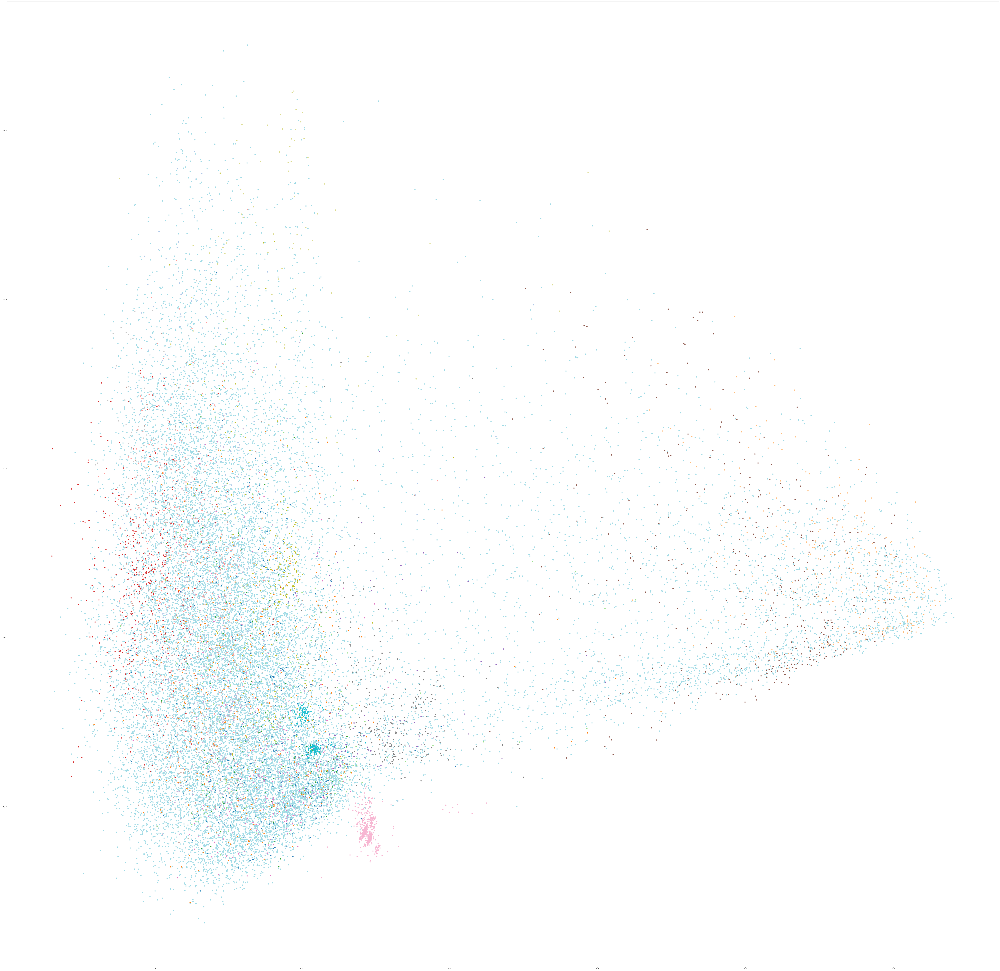

In [58]:

plot_cluster(video2_df, desc_model, desc_vectors)

In [59]:
desc_model_50, desc_vectors_50 = cluster_by_col(
    video2_df, 'description_Clean', 50, 50)

begin training
training complete
36771


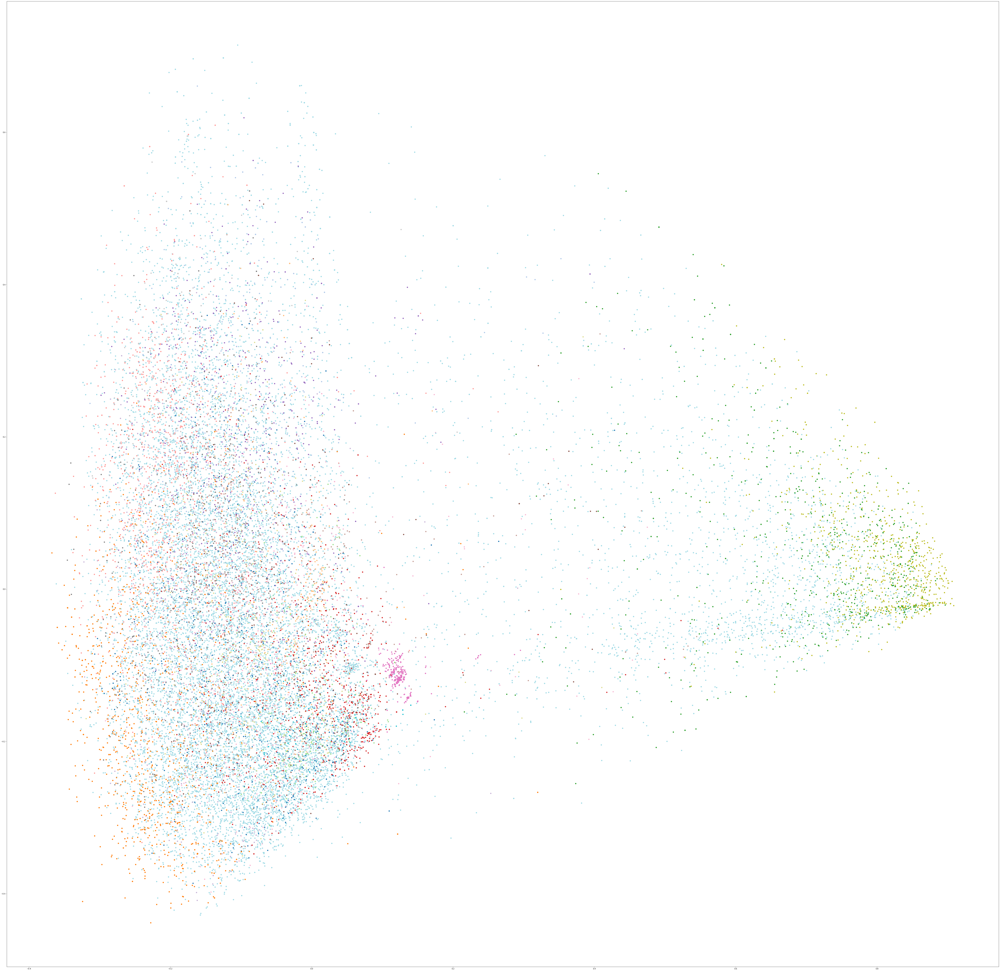

In [60]:
plot_cluster(video2_df, desc_model_50, desc_vectors_50)

In [61]:
desc_model_20, desc_vectors_20 = cluster_by_col(
    video2_df, 'description_Clean', 20, 20)

begin training
training complete
36771


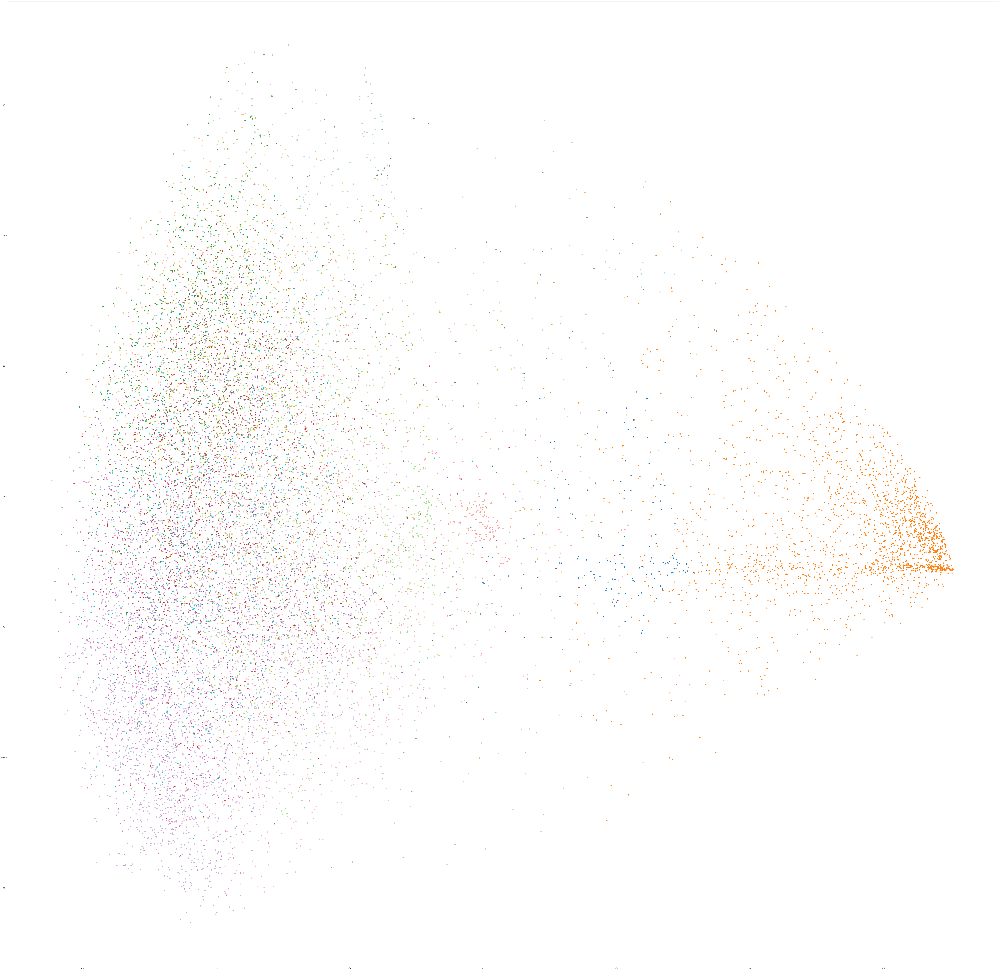

In [62]:
plot_cluster(video2_df, desc_model_20, desc_vectors_20)

In [65]:
title_model_100, title_vectors_100 = cluster_by_col(
    video2_df, 'title_Clean', 100, 100)

begin training
training complete
37389


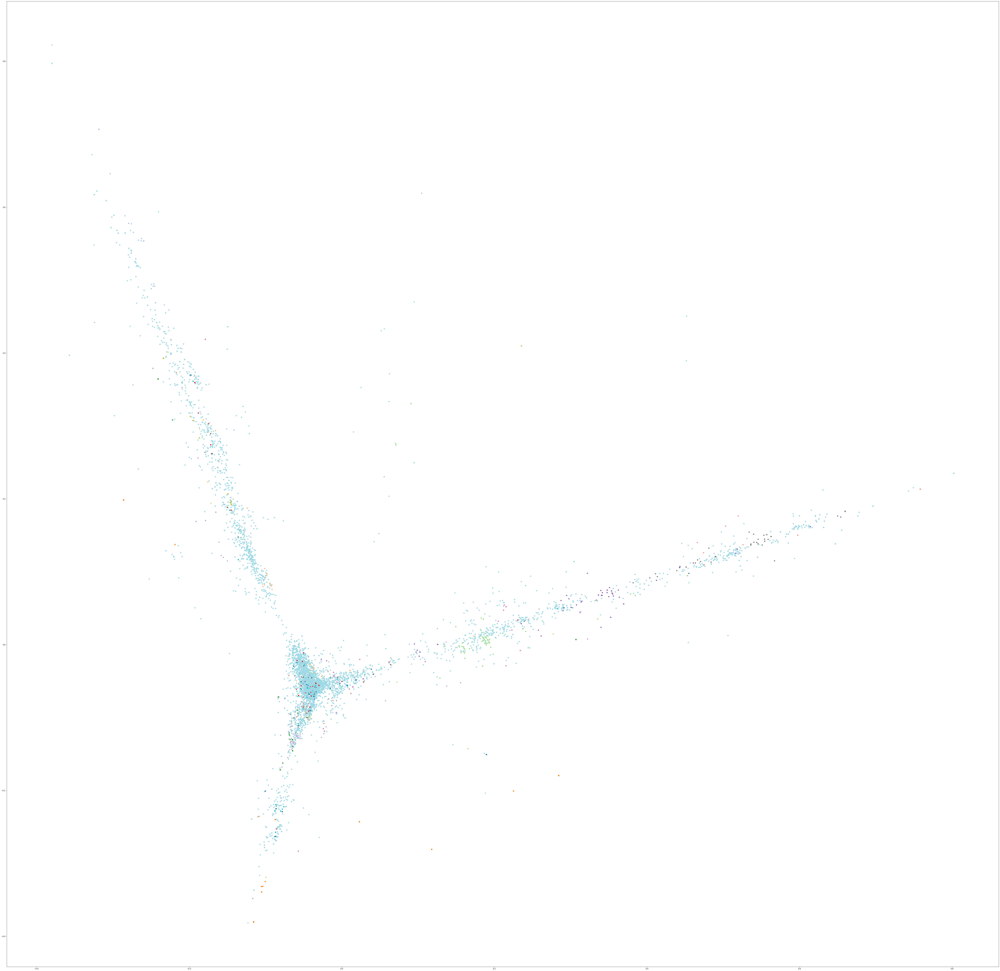

In [66]:
plot_cluster(video2_df, title_model_100, title_vectors_100)

In [67]:
title_model_50, title_vectors_50 = cluster_by_col(
    video2_df, 'title_Clean', 50, 50)

begin training
training complete
37389


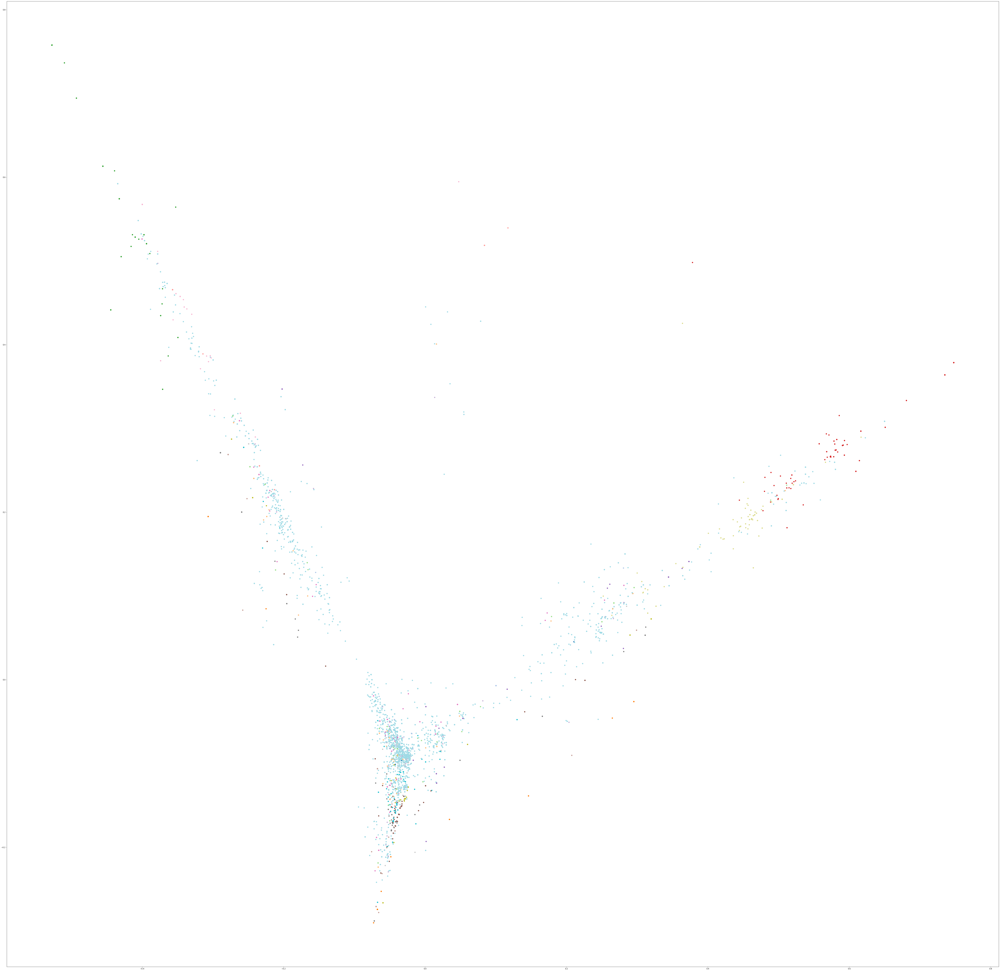

In [68]:
plot_cluster(video2_df, title_model_50, title_vectors_50)

In [69]:
title_model_20, title_vectors_20 = cluster_by_col(
    video2_df, 'title_Clean', 20, 20)

begin training
training complete
37389


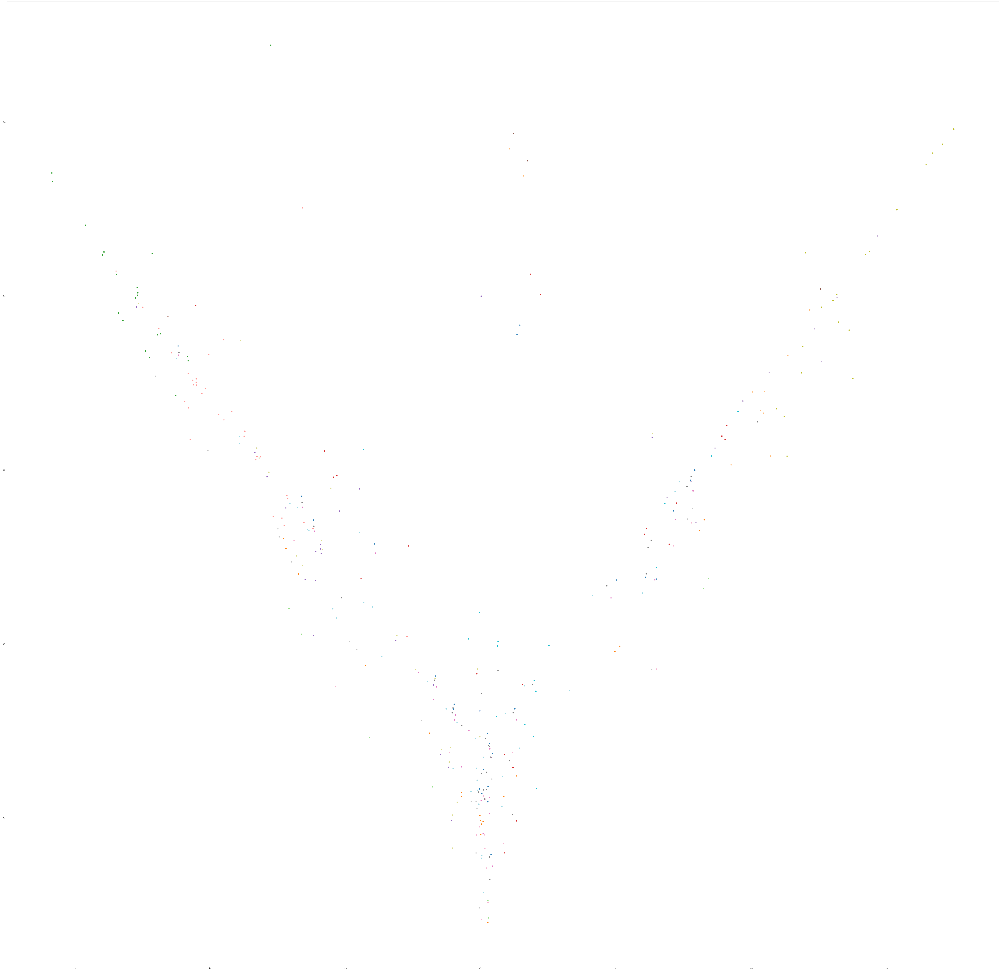

In [70]:
plot_cluster(video2_df, title_model_20, title_vectors_20)

In [71]:
ts_model_100, ts_vectors_100 = cluster_by_col(
    video2_df, 'Transcript_Blob_Clean', 100, 100)

begin training
training complete
20940


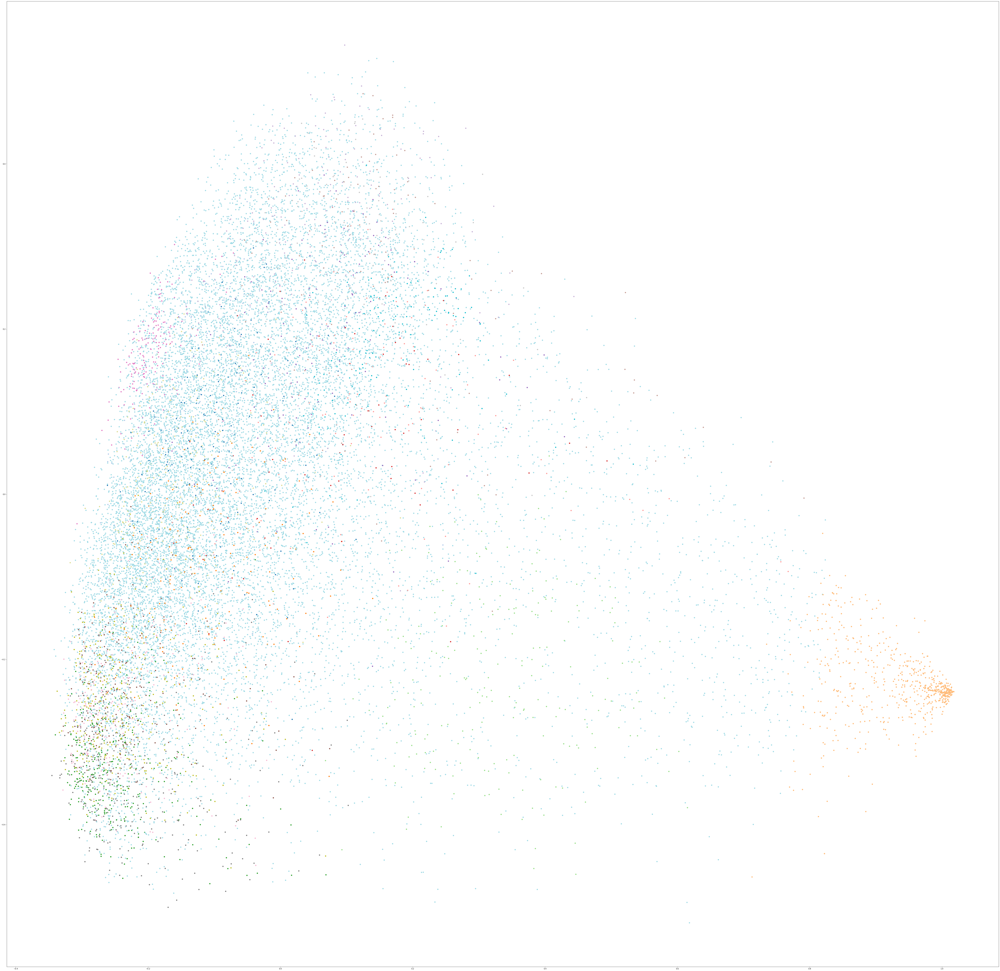

In [72]:
plot_cluster(video2_df, ts_model_100, ts_vectors_100)

In [73]:
ts_model_50, ts_vectors_50 = cluster_by_col(
    video2_df, 'Transcript_Blob_Clean', 50, 50)

begin training
training complete
20940


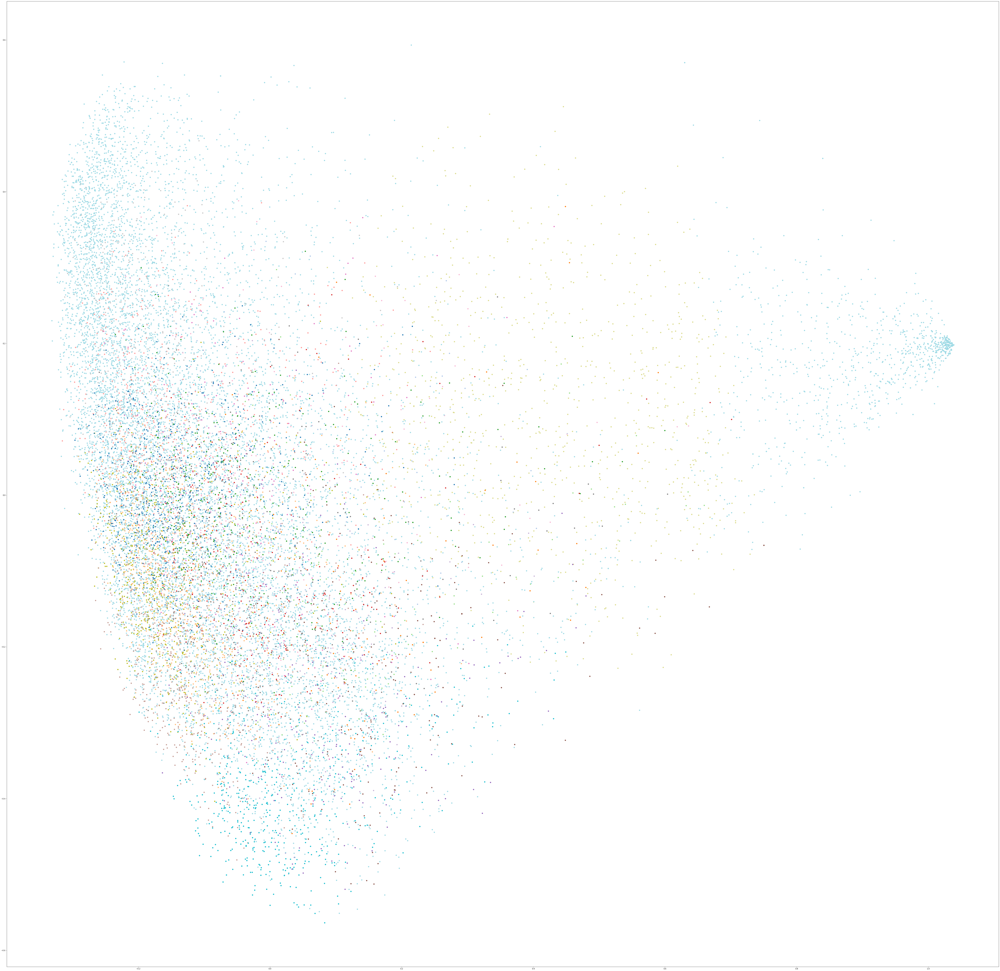

In [74]:
plot_cluster(video2_df, ts_model_50, ts_vectors_50)

In [75]:
ts_model_20, ts_vectors_20 = cluster_by_col(
    video2_df, 'Transcript_Blob_Clean', 20, 20)

begin training
training complete
20940


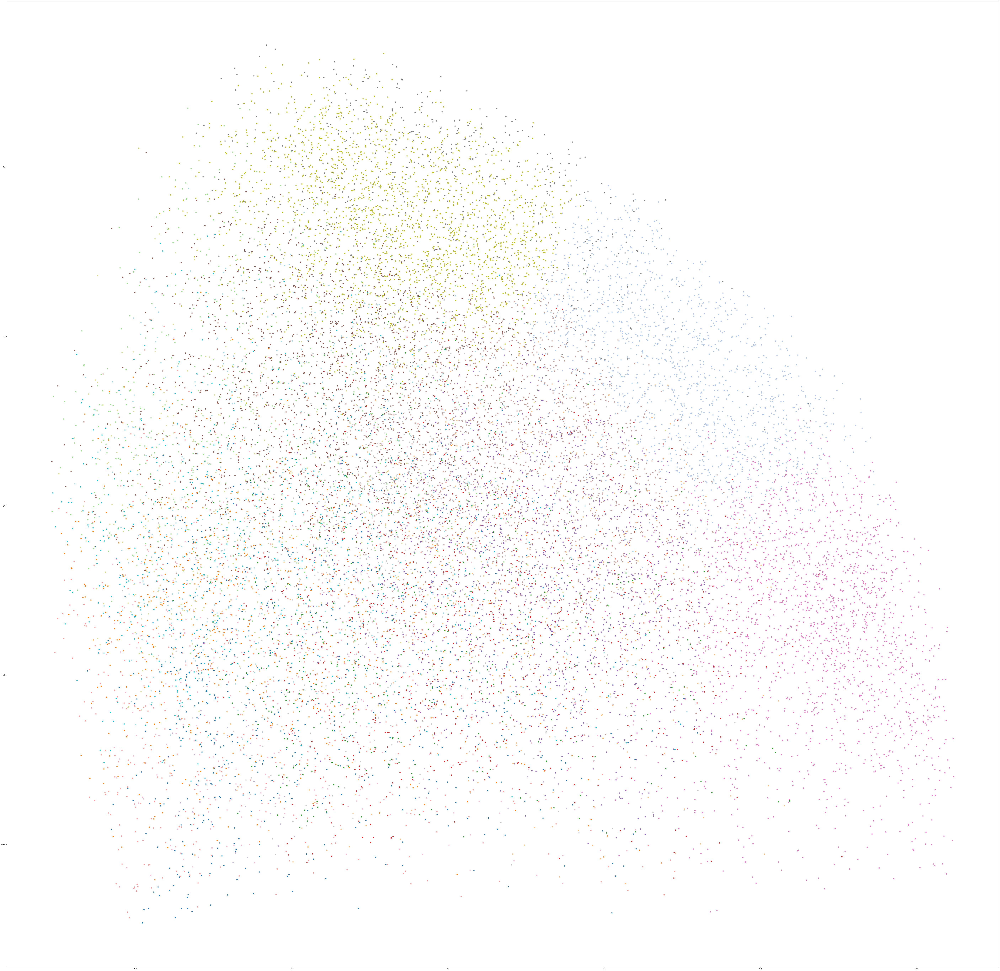

In [76]:
plot_cluster(video2_df, ts_model_20, ts_vectors_20)